<a href="https://colab.research.google.com/github/thoid/CFD-with-NN/blob/main/Research_Winter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import


In [67]:
import numpy as np
import pandas as pd
import copy
from matplotlib import pyplot as plt
import tensorflow as tf

!pip install -q ipywidgets


*   Set the value Reduction to true if you don't have the data reduced yet
*   Set the value Training to true if you want to train the model because you don't have the model yet
*   Set the value hyperparameter to true if you want to hyperparameter tuning
*   Set VM to true if you use a VM if not you will need to connect to google drive


In [68]:
Reduction = False
Training = False
Hyperparameter = False
VM = False

In [69]:
if VM:
  url = ''
else:
  from google.colab import drive
  drive.mount('/content/drive', force_remount=True)
  url ='/content/drive/MyDrive/'


Mounted at /content/drive


In [70]:
dfs = []

for i in range(64):
    filename = f"data{i}.csv"
    df = pd.read_csv(url + 'Research_Project/Winter/Dataset/' + filename)
    dfs.append(df)

dfs[63]["PMV"].describe()

count    83184.000000
mean        -0.720770
std          0.168734
min         -1.520000
25%         -0.800000
50%         -0.624000
75%         -0.603000
max         -0.570000
Name: PMV, dtype: float64

In [71]:
if not Reduction :
  dfs_rd = []
  for i in range(64):
    filename = f"data_reduced{i}.csv"
    df = pd.read_csv(url + 'Research_Project/Winter/Dataset_rd/' + filename)
    dfs_rd.append(df)

# Sol Air Temperature

## Sol Air Temperature Calculation

In [72]:
A_window = 1.8*2
A_wall =  2.5*2-1.8*2

U_window_Winter = 4.15
U_wall_Winter = 3.41

In [73]:
temp = pd.read_excel(url + 'Research_Project/SAT/temp.xlsx')
temp = pd.melt(temp, id_vars=['Jour'], var_name='Heure', value_name='Outdoor Air Temperature')
temp= temp.sort_values(by=['Jour', 'Heure'])

temp

,Jour,Heure,Outdoor Air Temperature
0,1,1,1.3
365,1,2,0.4
730,1,3,0.5
1095,1,4,0.8
1460,1,5,0.3
...,...,...,...
7299,365,20,1.8
7664,365,21,1.1
8029,365,22,1.3
8394,365,23,0.9


In [74]:
atmo = pd.read_excel(url + 'Research_Project/SAT/atmo.xlsx')
atmo = pd.melt(atmo, id_vars=['Jour'], var_name='Heure', value_name='Atmospheric Radiation')
atmo= atmo.sort_values(by=['Jour', 'Heure'])

atmo

,Jour,Heure,Atmospheric Radiation
0,1,1,0.99
365,1,2,0.98
730,1,3,0.98
1095,1,4,0.99
1460,1,5,0.99
...,...,...,...
7299,365,20,1.03
7664,365,21,1.01
8029,365,22,1.00
8394,365,23,0.99


In [75]:
df_calcul = pd.merge(temp, atmo, on=['Jour', 'Heure'])

df_calcul['Atmospheric Radiation'] = df_calcul['Atmospheric Radiation'].apply(lambda x: x * (10**6/3600))
df_calcul['Ground Surface Longwave Radiation'] = 5.67 * 10**-8 * (df_calcul['Outdoor Air Temperature'] + 273)**4
df_calcul['Effective Longwave Radiation'] =df_calcul['Ground Surface Longwave Radiation'] - df_calcul['Atmospheric Radiation']
df_calcul['Vertical Effective Longwave Radiation'] = 0.5 * df_calcul['Effective Longwave Radiation']
df_calcul['Sol Air Temperature'] = df_calcul['Outdoor Air Temperature'] - 0.77/34 * df_calcul['Vertical Effective Longwave Radiation']
df_calcul


,Jour,Heure,Outdoor Air Temperature,Atmospheric Radiation,Ground Surface Longwave Radiation,Effective Longwave Radiation,Vertical Effective Longwave Radiation,Sol Air Temperature
0,1,1,1.3,275.000000,320.986147,45.986147,22.993073,0.779275
1,1,2,0.4,272.222222,316.794111,44.571889,22.285944,-0.104711
2,1,3,0.5,272.222222,317.257854,45.035631,22.517816,-0.009962
3,1,4,0.8,275.000000,318.652136,43.652136,21.826068,0.305704
4,1,5,0.3,275.000000,316.330877,41.330877,20.665439,-0.168011
...,...,...,...,...,...,...,...,...
8755,365,20,1.8,286.111111,323.332956,37.221845,18.610922,1.378517
8756,365,21,1.1,280.555556,320.051009,39.495454,19.747727,0.652772
8757,365,22,1.3,277.777778,320.986147,43.208369,21.604184,0.810729
8758,365,23,0.9,275.000000,319.117917,44.117917,22.058958,0.400429


## Winter Temperature

In [76]:
df_Winter = df_calcul[(df_calcul['Outdoor Air Temperature'] < 8) & (df_calcul['Heure'] > 17)]

df_Winter

,Jour,Heure,Outdoor Air Temperature,Atmospheric Radiation,Ground Surface Longwave Radiation,Effective Longwave Radiation,Vertical Effective Longwave Radiation,Sol Air Temperature
17,1,18,1.4,277.777778,321.454483,43.676705,21.838353,0.905426
18,1,19,1.4,277.777778,321.454483,43.676705,21.838353,0.905426
19,1,20,1.9,280.555556,323.803858,43.248302,21.624151,1.410277
20,1,21,2.3,280.555556,325.692610,45.137054,22.568527,1.788889
21,1,22,1.2,275.000000,320.518322,45.518322,22.759161,0.684572
...,...,...,...,...,...,...,...,...
8755,365,20,1.8,286.111111,323.332956,37.221845,18.610922,1.378517
8756,365,21,1.1,280.555556,320.051009,39.495454,19.747727,0.652772
8757,365,22,1.3,277.777778,320.986147,43.208369,21.604184,0.810729
8758,365,23,0.9,275.000000,319.117917,44.117917,22.058958,0.400429


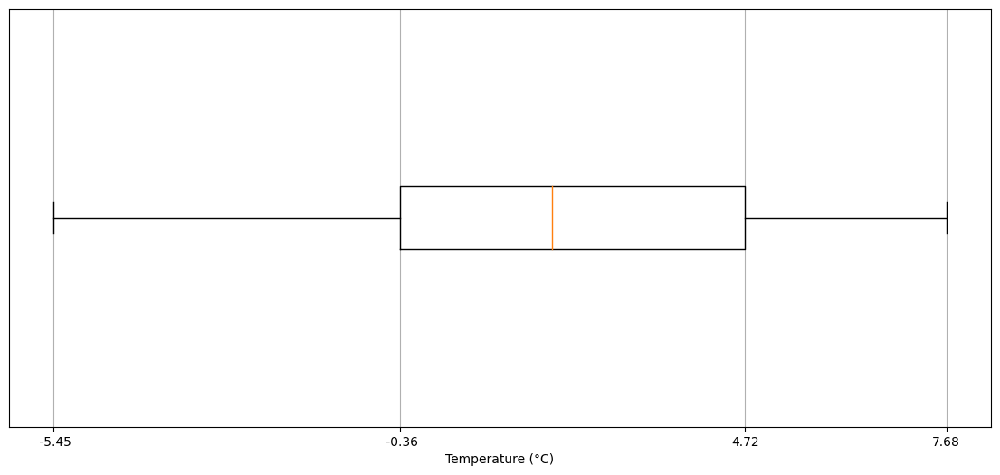

In [77]:
q1 = df_Winter['Sol Air Temperature'].quantile(0.25)
q3 = df_Winter['Sol Air Temperature'].quantile(0.75)
min = df_Winter['Sol Air Temperature'].min()
max = df_Winter['Sol Air Temperature'].max()


# Créer le boxplot
plt.figure(figsize=(14, 6))
plt.boxplot(df_Winter['Sol Air Temperature'], vert=False, whis = [0,100])
plt.xlabel('Temperature (°C)')
plt.yticks([])
plt.grid(True)

# Ajouter les marqueurs pour les valeurs caractéristiques
plt.xticks([min,q1, q3,max], [' {:.2f}'.format(min),' {:.2f}'.format(q1), '{:.2f}'.format(q3),'{:.2f}'.format(max)])

plt.show()

In [78]:
T_min_ref_Winter = 15
T_2_Winter = 17
T_3_Winter = 20
T_max_ref_Winter = 22

Q_max_1 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (min - T_min_ref_Winter)
Q_min_1 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (min - T_max_ref_Winter)
Q_3_1 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (min - T_2_Winter)
Q_2_1 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (min - T_3_Winter)

Q_max_2 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (q1 - T_min_ref_Winter)
Q_min_2 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (q1 - T_max_ref_Winter)
Q_3_2 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (q1 - T_2_Winter)
Q_2_2 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (q1 - T_3_Winter)

Q_max_3 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (q3 - T_min_ref_Winter)
Q_min_3 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (q3 - T_max_ref_Winter)
Q_3_3 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (q3 - T_2_Winter)
Q_2_3 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (q3 - T_3_Winter)

Q_max_4 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (max - T_min_ref_Winter)
Q_min_4 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (max - T_max_ref_Winter)
Q_3_4 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (max - T_2_Winter)
Q_2_4 = -(A_window * U_window_Winter + A_wall * U_wall_Winter) * (max - T_3_Winter)



power_table = pd.DataFrame({
    'SAT': [min, q1, q3, max],
    'Qmin': [Q_min_1, Q_min_2, Q_min_3, Q_min_4],
    'Q2': [Q_2_1, Q_2_2, Q_2_3, Q_2_4],
    'Q3': [Q_3_1, Q_3_2, Q_3_3, Q_3_4],
    'Qmax': [Q_max_1, Q_max_2, Q_max_3, Q_max_4]
})

Q_list = np.array([ Q_min_1, Q_2_1 , Q_3_1, Q_max_1, Q_min_2, Q_2_2, Q_3_2, Q_max_2, Q_min_3, Q_2_3, Q_3_3, Q_max_3,Q_min_4, Q_2_4, Q_3_4, Q_max_4])

power_table

,SAT,Qmin,Q2,Q3,Qmax
0,-5.447037,541.090889,501.662889,442.520889,403.092889
1,-0.357947,440.764564,401.336564,342.194564,302.766564
2,4.719920,340.659505,301.231505,242.089505,202.661505
3,7.677163,282.360409,242.932409,183.790409,144.362409


# Data Splitting

In [79]:
index_train = [0,1,3,4,6,7,8,9,11,12,13,14,16,17,18,20,21,23,24,26,27,29,30,31,32,33,35,37,38,39,40,41,42,44,46,47,48,50,51,52,53,54,57,58,59,60,61,63]
index_test = [2,10,15,19,22,28,36,43,45,49,55,56]
index_val=[5,25,34,62]
index_train_plot = [1,8,15,21,28,34]
index_test_plot = [0,2,4,6,7,9]

Name_train = [str(i) for i in index_train]
Name_test = [str(i) for i in index_test]
Name_val = [str(i) for i in index_val]
Name_train_plot = [str(i) for i in index_train_plot]
Name_test_plot = [str(i) for i in index_test_plot]

In [80]:
y_train = np.array([dfs[i].loc[:, 'PMV'] for i in index_train])
y_test = np.array([dfs[i].loc[:, 'PMV'] for i in index_test])
y_val = np.array([dfs[i].loc[:, 'PMV'] for i in index_val])

y_train_plot = np.array([y_train[i] for i in index_train_plot])
y_test_plot = np.array([y_test[i] for i in index_test_plot])

X_tot = np.array([
    [1,-5.45,600], [1,-5.45,571],[1,-5.45,541],[1,-5.45,502],
    [1,-0.36,500], [1,-0.36,470], [1,-0.36,440], [1,-0.36,401],
    [1,4.72,400], [1,4.72,370], [1,4.72,340], [1,4.72,301],
    [1,7.68,341], [1,7.68,312], [1,7.68,282], [1,7.68,242],

    [2,-5.45,600], [2,-5.45,571],[2,-5.45,541],[1,-5.45,502],
    [2,-0.36,500], [2,-0.36,470], [2,-0.36,440], [2,-0.36,401],
    [2,4.72,400], [2,4.72,370], [2,4.72,340], [2,4.72,301],
    [2,7.68,341], [2,7.68,312], [2,7.68,282], [2,7.68,242],

    [3,-5.45,600], [3,-5.45,571],[3,-5.45,541],[1,-5.45,502],
    [3,-0.36,500], [3,-0.36,470], [3,-0.36,440], [3,-0.36,401],
    [3,4.72,400], [3,4.72,370], [3,4.72,340], [3,4.72,301],
    [2,7.68,341], [3,7.68,312], [3,7.68,282], [3,7.68,242],

    [4,-5.45,600], [4,-5.45,571],[4,-5.45,541],[1,-5.45,502],
    [4,-0.36,500], [4,-0.36,470], [4,-0.36,440], [4,-0.36,401],
    [4,4.72,400], [4,4.72,370], [4,4.72,340], [4,4.72,301],
    [4,7.68,341], [4,7.68,312], [4,7.68,282], [4,7.68,242]
    ])

X_train = np.array([X_tot[i] for i in index_train])
X_test = np.array([X_tot[i] for i in index_test])
X_val = np.array([X_tot[i] for i in index_val])

In [81]:
print(np.max(y_train))
print(np.min(y_train))
print(np.max(y_test))
print(np.min(y_test))
print(np.max(y_val))
print(np.min(y_val))

2.26
-2.13
1.73
-2.14
1.3
-1.77


In [82]:
def data_base(dataset):
  colonne_X = np.round(dataset['X[m]'],3)
  colonne_Y = np.round(dataset['Y[m]'],3)
  colonne_Z = np.round(dataset['Z[m]'],3)

  return pd.DataFrame({'X[m]': colonne_X, 'Y[m]': colonne_Y, 'Z[m]': colonne_Z})

df_base = data_base(dfs[0])


# Plots and Analysis

## Plot Functions

In [83]:
def plot(pmv_values,df_base, figure_names,z_val = 1.025):

  num_plots = len(pmv_values)
  num_cols = 2

  if num_plots % 3 == 0:
    num_cols = 3

  num_rows = (num_plots + num_cols - 1) // num_cols

  fig, ax_main = plt.subplots(num_rows, num_cols, figsize=(20, 7))
  for i, (data, name) in enumerate(zip(pmv_values, figure_names)):

    df_b = df_base.copy()
    df_b['PMV'] = pmv_values[i]
    df_z = df_b[df_b['Z[m]'] == z_val]
    row_idx = i // num_cols
    col_idx = i % num_cols

    X = df_z['X[m]']
    Y = df_z['Y[m]']
    PMV = df_z['PMV']

    marker_size = 100

    im = ax_main[row_idx, col_idx].scatter(X, Y, c=PMV, vmin= -2.14, vmax= 2.26, cmap='jet', marker='s')
    ax_main[row_idx, col_idx].set_xlabel('X (m)', fontsize = 25)
    ax_main[row_idx, col_idx].set_ylabel('Y (m)', fontsize = 25)
    ax_main[row_idx, col_idx].set_xlim(0, 5)
    ax_main[row_idx, col_idx].set_ylim(0, 2)
    ax_main[row_idx, col_idx].set_title("Data Number : {}".format(name), fontsize = 25)

    ax_main[row_idx, col_idx].tick_params(axis='x', labelsize=20)
    ax_main[row_idx, col_idx].tick_params(axis='y', labelsize=20)

  cbar_ax = fig.add_axes([0.1, -0.1, 0.8, 0.05])  # [left, bottom, width, height]
  cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal')
  cbar.ax.tick_params(labelsize=20)
  cbar.set_label("PMV", fontsize=20)

  plt.tight_layout()
  plt.show()


In [84]:
import plotly.graph_objects as go
import pandas as pd
import ipywidgets as widgets
from IPython.display import display, clear_output

def interactiv_3D_plot(df1,df2,title):

  min_color_value = np.min([df1['PMV'].min(), df2['PMV'].min()])
  max_color_value = np.max([df1['PMV'].max(), df2['PMV'].max()])

  x_range = [0, 5]
  y_range = [0, 2]
  z_range = [0, 1.2]

  aspect_ratio = dict(x=2.5, y=1, z=0.6)

  fig = go.Figure()

  # Add first subplot
  fig.add_trace(go.Scatter3d(
      x=df1['X[m]'],
      y=df1['Y[m]'],
      z=df1['Z[m]'],
      mode='markers',
      marker=dict(
          size=5,
          color=df1['PMV'],                # set color to the PMV values
          colorscale='Jet',
          cmin = min_color_value,
          cmax = max_color_value,
          colorbar=dict(title='PMV'),
          opacity=0.8
      ),
      scene="scene1"
  ))

  # Add second subplot
  fig.add_trace(go.Scatter3d(
      x=df2['X[m]'],
      y=df2['Y[m]'],
      z=df2['Z[m]'],
      mode='markers',
      marker=dict(
          size=5,
          color=df2['PMV'],                # set color to the PMV values
          colorscale='Jet',
          cmin = min_color_value,
          cmax = max_color_value,
          opacity=0.8
      ),
      scene="scene2",
      name = 'test'
  ))

  # Update layout for subplot 1
  fig.update_layout(
      height=800,
      scene=dict(
          camera=dict(
              up=dict(x=0, y=0, z=1),
              center=dict(x=0, y=0, z=0),
              eye=dict(x=-2, y=-2, z=1.25)),
          xaxis_title='X',
          yaxis_title='Y',
          zaxis_title='Z',
          xaxis=dict(range=x_range),
          yaxis=dict(range=y_range),
          zaxis=dict(range=z_range),
          aspectratio=aspect_ratio,
          domain=dict(x=[0, 0.45])
      ),
      scene2=dict(
          camera=dict(
              up=dict(x=0, y=0, z=1),
              center=dict(x=0, y=0, z=0),
              eye=dict(x=-2, y=-2, z=1.25)),
          xaxis_title='X',
          yaxis_title='Y',
          zaxis_title='Z',
          xaxis=dict(range=x_range),
          yaxis=dict(range=y_range),
          zaxis=dict(range=z_range),
          aspectratio=aspect_ratio,
          domain=dict(x=[0.55, 1])
      ),

    annotations=[
        dict(
            text=title[0],
            x=0.150,
            y=1.05,
            showarrow=False,
            font=dict(size=20)
        ),
        dict(
            text=title[1],
            x=0.850,
            y=1.05,
            showarrow=False,
            font=dict(size=20)
        )
    ]
  )

  fig.show()

  def plot_3D(df1,df2, z=-1, y=-1, x=-1):
    if z > 0:
        df_1 = df1[df1['Z[m]'] == z]
        df_2 = df2[df2['Z[m]'] == z]
    elif y > 0:
        df_1 = df1[df1['Y[m]'] == y]
        df_2 = df2[df2['Y[m]'] == y]
    elif x > 0:
        df_1 = df1[df1['X[m]'] == x]
        df_2 = df2[df2['X[m]'] == x]
    else:
        df_1 = df1
        df_2 = df2

    fig.data[0].x = df_1['X[m]']
    fig.data[0].y = df_1['Y[m]']
    fig.data[0].z = df_1['Z[m]']
    fig.data[0].marker['color'] = df_1['PMV']

    fig.data[1].x = df_2['X[m]']
    fig.data[1].y = df_2['Y[m]']
    fig.data[1].z = df_2['Z[m]']
    fig.data[1].marker['color'] = df_2['PMV']

    fig.show()


  x_slider = widgets.FloatSlider(min=0.025, max=4.975, step=0.05, description='X:')
  y_slider = widgets.FloatSlider(min=0.025, max=1.975, step=0.05, description='Y:')
  z_slider = widgets.FloatSlider(min=0.025, max=1.175, step=0.05, description='Z:')


  def update_plot(change, curseur):

    clear_output(wait=True)

    if curseur == 'x':
        plot_3D(df1,df2, x=change.new)
    elif curseur == 'y':
        plot_3D(df1,df2, y=change.new)
    elif curseur == 'z':
        plot_3D(df1,df2, z=change.new)

    spacer_left = widgets.Label(layout=widgets.Layout(flex='1 1 auto'))
    spacer_right = widgets.Label(layout=widgets.Layout(flex='1 1 auto'))
    grid = widgets.GridspecLayout(3, 3)
    grid[0, 1] = x_slider
    grid[1, 1] = y_slider
    grid[2, 1] = z_slider
    grid[1, 0] = spacer_left
    grid[1, 2] = spacer_right

    display(grid)

  x_slider.observe(lambda change: update_plot(change, 'x'), 'value')
  y_slider.observe(lambda change: update_plot(change, 'y'), 'value')
  z_slider.observe(lambda change: update_plot(change, 'z'), 'value')

  spacer_left = widgets.Label(layout=widgets.Layout(flex='1 1 auto'))
  spacer_right = widgets.Label(layout=widgets.Layout(flex='1 1 auto'))
  grid = widgets.GridspecLayout(3, 3)
  grid[0, 1] = x_slider
  grid[1, 1] = y_slider
  grid[2, 1] = z_slider
  grid[1, 0] = spacer_left
  grid[1, 2] = spacer_right

  display(grid)

## Plot at Z = 1m

<ipython-input-83-5edb99b9a23e>:41: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



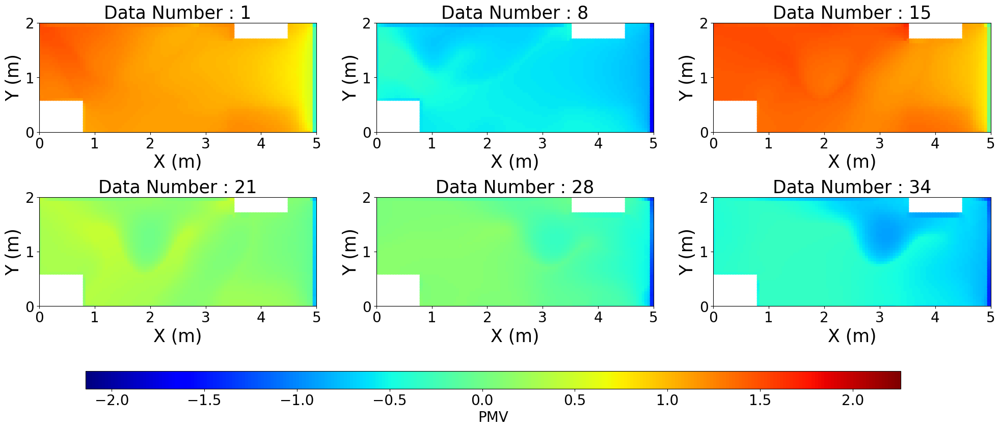

In [85]:
plot(y_train_plot,df_base,Name_train_plot,0.975)

<ipython-input-83-5edb99b9a23e>:41: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



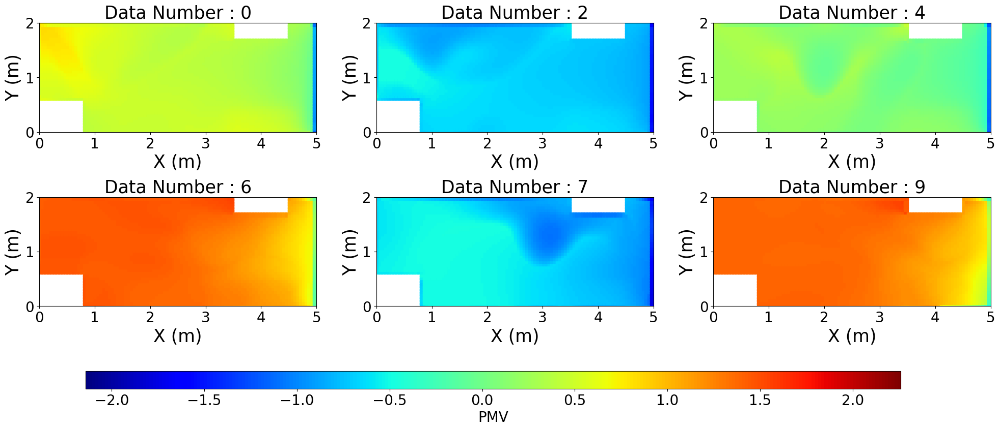

In [86]:
plot(y_test_plot,df_base,Name_test_plot,0.975)

## Interactive Plot

In [87]:
#13,28,43,58
interactiv_3D_plot(dfs[15], dfs[63],['Yac = 1m','Yac = 4m'])

GridspecLayout(children=(FloatSlider(value=0.025, description='X:', layout=Layout(grid_area='widget001'), max=…

## Data Analysis

In [88]:
dfs[13]["PMV"].describe()

count    83184.000000
mean         0.269938
std          0.240170
min         -0.985000
25%          0.134000
50%          0.325000
75%          0.413000
max          0.664000
Name: PMV, dtype: float64

In [89]:
dfs[58]["PMV"].describe()

count    83184.000000
mean        -0.215261
std          0.189600
min         -1.370000
25%         -0.331000
50%         -0.106000
75%         -0.083400
max         -0.026600
Name: PMV, dtype: float64

In [90]:
std_values = [df['PMV'].std() for df in dfs]

(0.0003598924609234021, 0.10317602412812094)


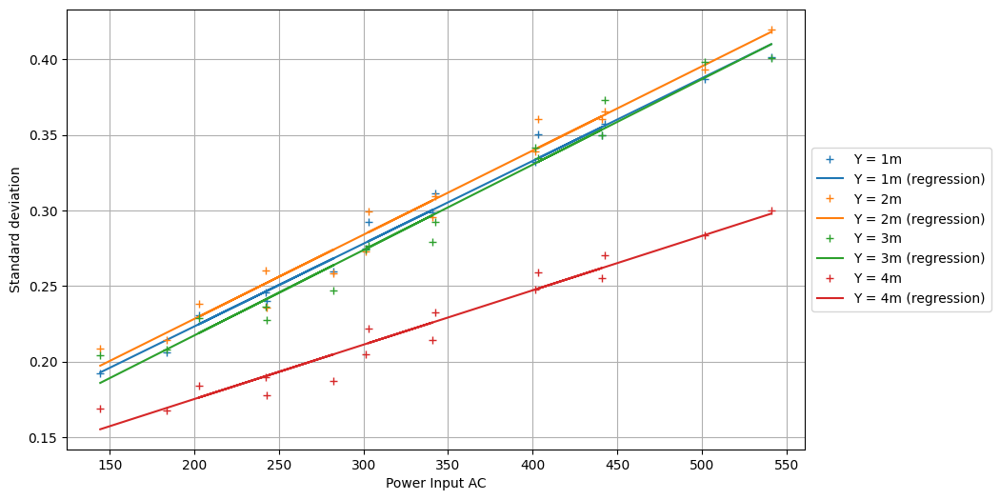

In [91]:
from scipy.stats import linregress

n = len(std_values)
split_size = n // 4

Y1 = std_values[:split_size]
Y2 = std_values[split_size:2*split_size]
Y3 = std_values[2*split_size:3*split_size]
Y4 = std_values[3*split_size:]

def plot_with_regression(Q, Y, label):
    plt.plot(Q, Y, '+', label=label)
    slope, intercept, _, _, _ = linregress(Q, Y)
    plt.plot(Q, slope * Q + intercept,color=plt.gca().lines[-1].get_color(), label=f'{label} (regression)')
    return slope,intercept

plt.figure(figsize=(10, 6))

plot_with_regression(Q_list, Y1, 'Y = 1m')
plot_with_regression(Q_list, Y2, 'Y = 2m')
plot_with_regression(Q_list, Y3, 'Y = 3m')
print(plot_with_regression(Q_list, Y4, 'Y = 4m'))


plt.xlabel('Power Input AC')
plt.ylabel('Standard deviation')
plt.grid(True)

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

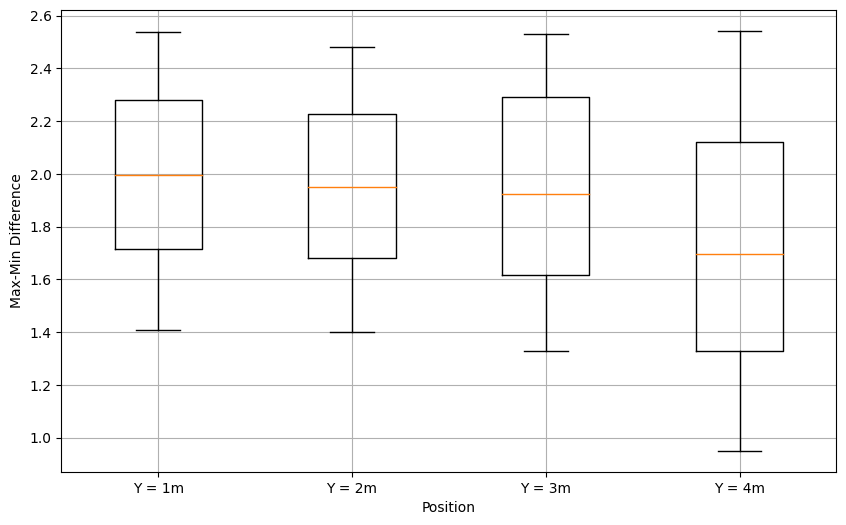

In [92]:
import numpy as np

def min_max(df):
    return np.abs(df['PMV'].max() - df['PMV'].min())


elem = [min_max(df) for df in dfs]

elem1 = elem[:split_size]
elem2 = elem[split_size:2*split_size]
elem3 = elem[2*split_size:3*split_size]
elem4 = elem[3*split_size:]

plt.figure(figsize=(10, 6))
plt.boxplot([elem1, elem2, elem3, elem4], labels=['Y = 1m', 'Y = 2m', 'Y = 3m', 'Y = 4m'])
plt.xlabel('Position')
plt.ylabel('Max-Min Difference')
plt.grid(True)

# Show the plot
plt.show()


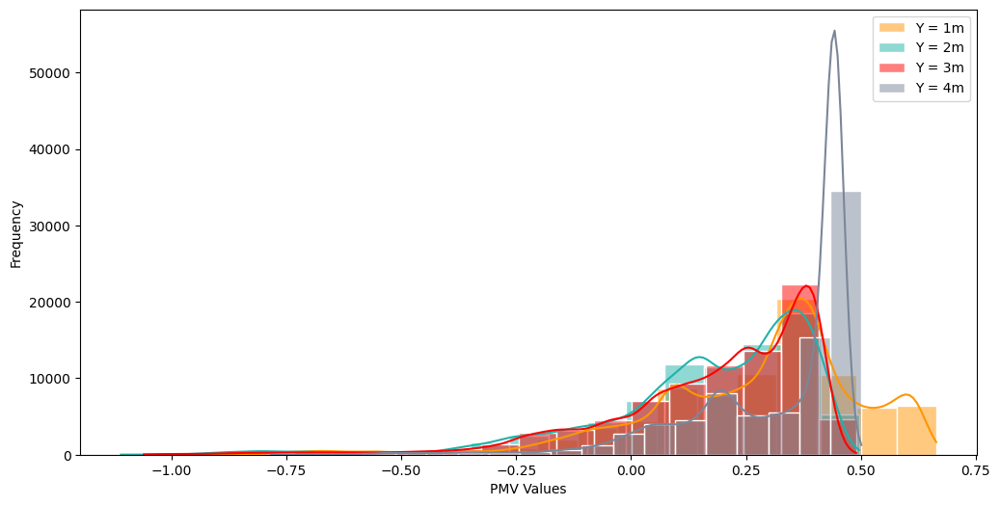

In [93]:
import seaborn as sns

plt.figure(figsize=(12, 6))

# Assuming dfs is your list or dictionary of DataFrames
sns.histplot(dfs[13]['PMV'], bins=19, edgecolor='white', kde=True, color="#FF9502", label='Y = 1m')
sns.histplot(dfs[29]['PMV'], bins=19, edgecolor='white', kde=True, color='lightseagreen', label='Y = 2m')
sns.histplot(dfs[45]['PMV'], bins=19, edgecolor='white', kde=True, color="red", label='Y = 3m')
sns.histplot(dfs[61]['PMV'], bins=19, edgecolor='white', kde=True, color="#7B8699", label='Y = 4m')

# Add a legend
plt.legend()
# Optionally customize other aspects of the plot
plt.xlabel('PMV Values')
plt.ylabel('Frequency')

# Display the plot
plt.show()


# Hyperparameters Optimization

In [94]:
if Hyperparameter:
  !pip3 install mlflow dagshub --quiet

  import dagshub
  import mlflow

  dagshub.init("Research", "thoid", mlflow=True)

In [95]:
!pip install hyperopt --quiet

from hyperopt import fmin, tpe, hp, STATUS_OK, Trials, space_eval

In [96]:
def best_model(X_train, y_train, X_val, y_val, output_neurons, params):

    if params['optimizers'] == 'Adam':
        opti = tf.keras.optimizers.Adam(learning_rate= params['learning_rate'])
    elif params['optimizers'] == 'RMSprop':
        opti = tf.keras.optimizers.RMSprop(learning_rate= params['learning_rate'])
    elif params['optimizers'] == 'SGD':
        opti = tf.keras.optimizers.SGD(learning_rate= params['learning_rate'])

    neurons = params['neurons']
    nb_hidden = params['nb_hidden']

    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Dense(5, input_shape=(3,)))

    for _ in range(nb_hidden):
        model.add(tf.keras.layers.Dense(neurons, activation=params['activation']))

    model.add(tf.keras.layers.Dense(output_neurons))

    model.compile(loss=tf.keras.losses.MeanSquaredError(), optimizer=opti)

    history = model.fit(X_train, y_train, epochs=params['epochs'], batch_size=1, verbose=0,
                        validation_data=(X_val, y_val))

    return model, history


In [97]:
space = {
    'neurons': hp.choice('neurons', [16, 32, 64, 128]),
    'optimizers': hp.choice('optimizers', ['Adam','RMSprop','SGD']),
    'nb_hidden': hp.choice('nb_hidden', [5, 10, 20]),
    'epochs' : hp.choice('epochs', [500]),
    'learning_rate' : hp.uniform("learnin_rate",0.001,0.01),
    'activation' : hp.choice('activation', ['relu', 'sigmoid','tanh'])
}

In [98]:
def objective(params):
    model, history = best_model(X_train, y_train, X_val, y_val, 83184, params)
    loss = history.history['val_loss'][-1]
    return {'loss': loss, 'status': STATUS_OK, 'model': model, 'params': params}

In [99]:
if Hyperparameter:
  trials = Trials()
  best_params = fmin(objective, space, algo=tpe.suggest, max_evals=200, trials=trials)
  space_eval(space, best_params)

In [100]:
if Hyperparameter:

  for trial in trials.trials:
    params = trial['result']['params']
    loss = trial['result']['loss']
    model = trial['result']['model']

    with mlflow.start_run():
        mlflow.log_params(params)
        mlflow.log_metric('val_loss', loss)

# Neural Network : Basic Case

## Model Definition and Training

In [101]:
import time
def create_model(neurons,optimizer, loss, output_neurons):

  model = tf.keras.models.Sequential([
    tf.keras.layers.Dense(5 , input_shape=(3,)), # input layer
    tf.keras.layers.Dense(neurons, activation='relu'), # 1st hiddden layer
    tf.keras.layers.Dense(neurons, activation='relu'),
    tf.keras.layers.Dense(neurons, activation='relu'),
    tf.keras.layers.Dense(neurons, activation='relu'),
    tf.keras.layers.Dense(neurons, activation='relu'),
    tf.keras.layers.Dense(output_neurons) # output layer
  ])
  model.compile(loss = loss, optimizer = optimizer)

  return model

In [102]:
import pickle
def train_model(X_train, y_train, X_val, y_val, output_neurons):
    model = create_model(64, tf.keras.optimizers.RMSprop(), tf.keras.losses.MeanSquaredError(), output_neurons)

    starting_time = time.time()

    history = model.fit(X_train, y_train, epochs=5000, batch_size=1, verbose=2,
                        validation_data=(X_val, y_val))

    training_time = time.time() - starting_time
    print("Training time:", training_time)
    return model, history

if Training:
  model, history = train_model(X_train, y_train,X_val,y_val,83184)
  model.save(url + 'Research_Project/Winter/Model/model_Winter.h5')
  with open(url + 'Research_Project/Winter/History/history_Winter.pkl', 'wb') as f:
    pickle.dump(history, f)

In [103]:
from keras.models import load_model

if not Training:

  model = load_model(url + 'Research_Project/Winter/Model/model_Winter.h5')
  with open(url + 'Research_Project/Winter/History/history_Winter.pkl', 'rb') as f:
    history = pickle.load(f)

## Training and Validation Loss

In [104]:
def training_loss(history):
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  epochs = range(1, len(loss) + 1)

  plt.plot(epochs, loss, 'b', label='Training loss')
  plt.plot(epochs, val_loss, 'r', label='Validation loss')
  plt.title('Training and Validation loss')
  plt.ylim(0,0.1)
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.legend()
  plt.show()

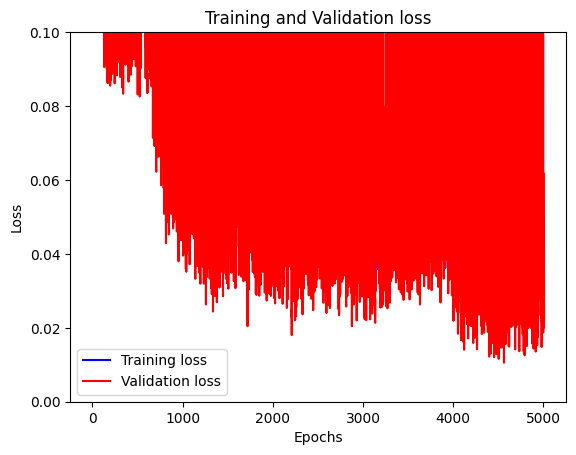

In [105]:
training_loss(history)

## Error Function

To evaluate the difference between CFD simulation and NN results :

$Error[i][j] = \left| \frac{{y_{NN}[i][j] - y_{CFD}[i][j]}}{{\max(y_{CFD}[i]) - \min(y_{CFD}[i])}} \right| \times 100
 $

In [106]:
def Erreur_relative(y_CFD, y_NN):
    y_CFD_max_min = np.ptp(y_CFD, axis=1)  # Calcul de la plage (max - min) de chaque ligne de y_CFD
    Erreur_relative = np.abs((y_NN - y_CFD) / y_CFD_max_min[:, np.newaxis]) * 100
    return Erreur_relative

## Results Analysis

### Test on Training Dataset

In [107]:
y_train_result = model.predict(X_train)

2/2 [==============================] - 0s 20ms/step


In [108]:
y_train_result_plot = np.array([y_train_result[i] for i in index_train_plot])

<ipython-input-83-5edb99b9a23e>:41: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



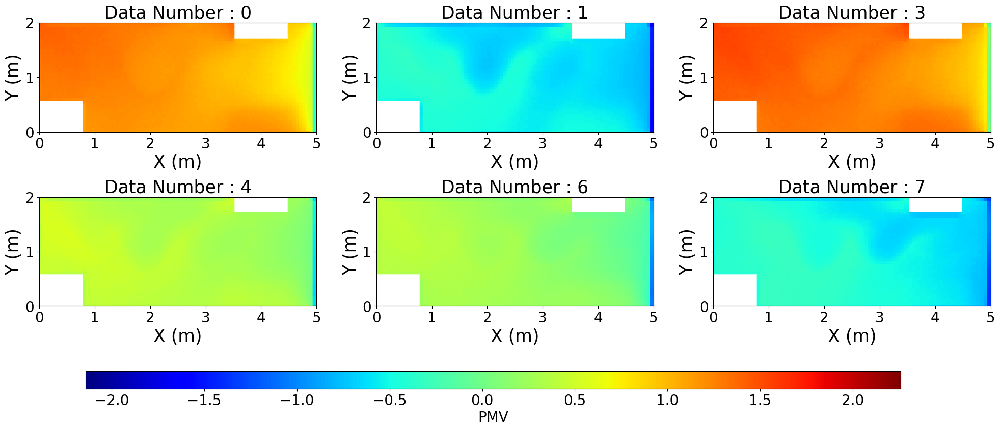

In [109]:
plot(y_train_result_plot,df_base,Name_train,0.975)

### Test on Testing Dataset

In [110]:
y_test_result = model.predict(X_test)

1/1 [==============================] - 0s 106ms/step


In [111]:
y_test_result_plot = np.array([y_test_result[i] for i in index_test_plot])

<ipython-input-83-5edb99b9a23e>:41: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



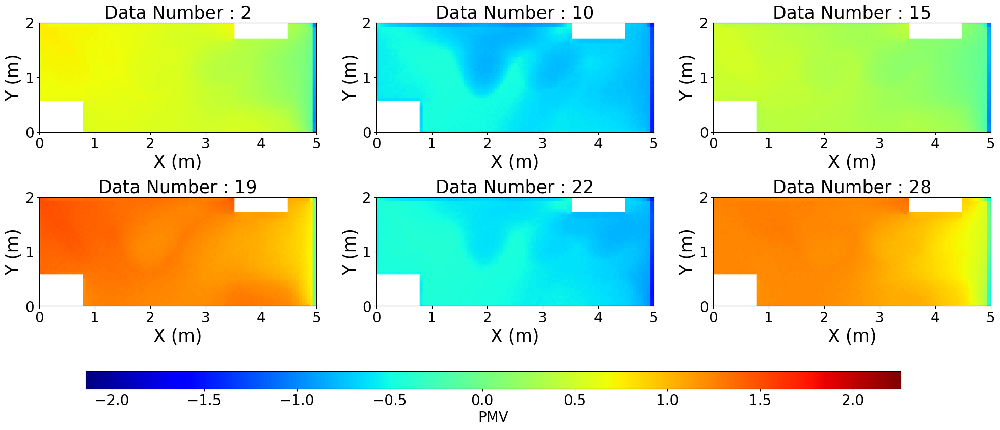

In [112]:
plot(y_test_result_plot,df_base,Name_test,0.975)

### Results Analysis

Results Functions

In [113]:
def result_tab(y, y_result, name):
  # Return a tab with the mean,min and max relative error
  Error = Erreur_relative(y, y_result)
  df = pd.DataFrame(Error)

  df['Mean Relative Error'] = df.mean(axis=1)
  df['Max Relative Error'] = df.max(axis=1)
  df['Min Relative Error'] = df.min(axis=1)
  df['Data Number'] = name
  df_output = df[['Data Number', 'Mean Relative Error', 'Max Relative Error', 'Min Relative Error']]
  return df_output.style.hide()


In [114]:
def boxplot(y, y_result, name, ymax):
    Error = Erreur_relative(y, y_result)
    Error = np.transpose(Error)
    df = pd.DataFrame(Error)

    fig, ax = plt.subplots(figsize=(20, 10))

    df.plot(kind='box', whis=[0, 100], ax=ax)

    # Définir la limite de l'axe y
    ax.set_ylim(0, ymax)
    ax.set_xticklabels(name)
    ax.set_xlabel('Data Number')
    ax.set_ylabel('Error (in percent)')

    plt.show()

In [115]:
def plot_3D_result(y1,y2,title):

  df1 = df_base.copy()
  df1['PMV'] = y1
  df2 = df_base.copy()
  df2['PMV'] = y2

  interactiv_3D_plot(df1, df2,title)

Result on Training Dataset

In [116]:
result_tab(y_train, y_train_result, Name_train)


Data Number,Mean Relative Error,Max Relative Error,Min Relative Error
0,3.162899,23.521033,0.000078
1,2.529164,23.714193,0.000021
3,4.505683,23.889454,0.000015
4,8.539018,16.399922,0.000491
6,7.522701,28.217837,0.002624
7,3.186916,22.496574,0.000046
8,4.157234,18.534861,0.000026
9,7.913039,32.029267,0.004393
11,4.534990,26.595757,0.000042
12,3.642687,23.338850,0.000012


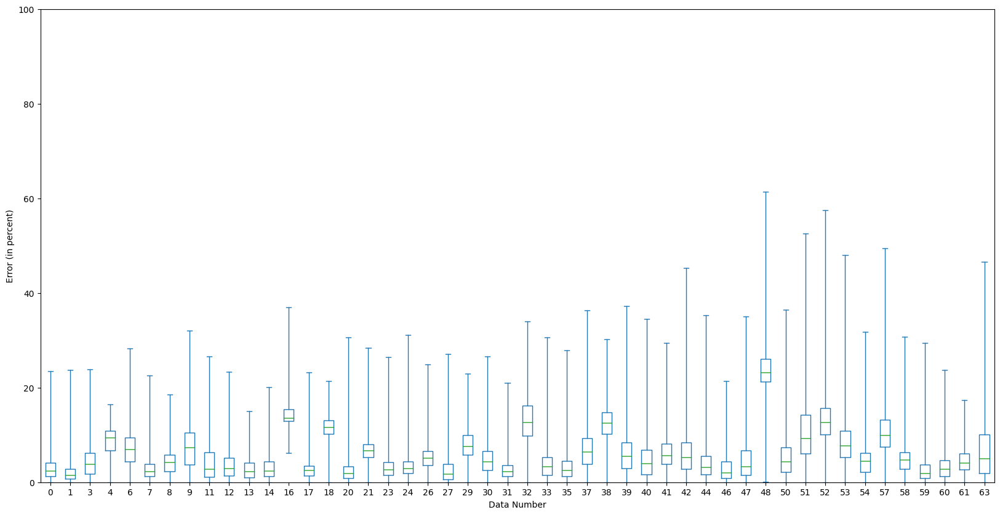

In [117]:
boxplot(y_train, y_train_result, Name_train,100)

Result on Testing Dataset

In [118]:
result_tab(y_test, y_test_result, Name_test)

Data Number,Mean Relative Error,Max Relative Error,Min Relative Error
2,5.295937,25.868714,0.000061
10,9.358476,32.034391,0.000250
15,8.700233,44.971099,0.000531
19,4.967127,24.351599,0.000097
22,8.321956,26.063546,0.001195
28,4.624070,34.179644,0.000256
36,5.820800,48.071274,0.000019
43,8.260912,35.366372,0.000437
45,7.860224,36.293505,0.000217
49,9.609563,46.039660,0.001135


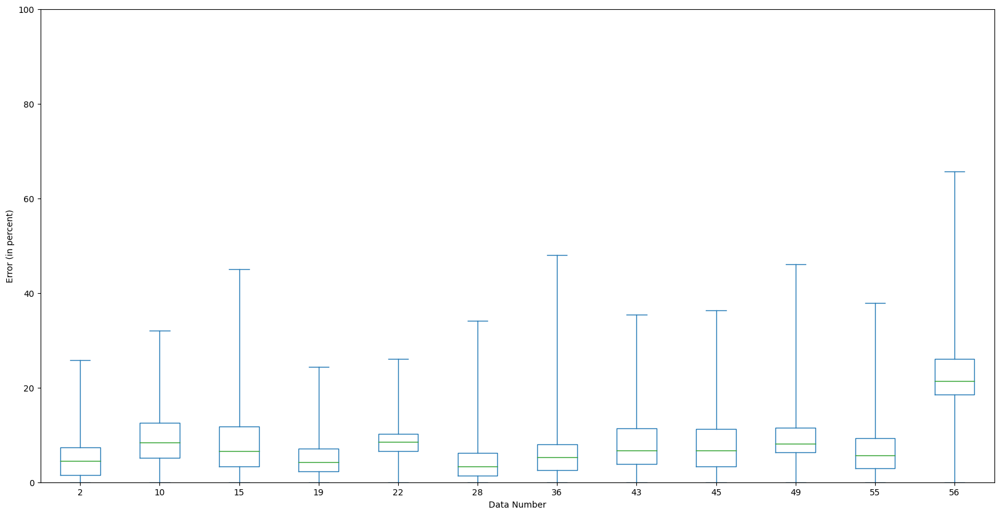

In [119]:
boxplot(y_test, y_test_result, Name_test,100)

In [120]:
plot_3D_result(y_test[0], y_test_result[0], ['Data','Result'])

GridspecLayout(children=(FloatSlider(value=0.025, description='X:', layout=Layout(grid_area='widget001'), max=…

# Neural Network : Reduction

## Data Reduction

In [121]:
def dimension_reduction(df):

  new_df = pd.DataFrame(columns=['X[m]', 'Y[m]', 'Z[m]', 'PMV'])
  # Définir la taille de chaque petit cube
  cube_size = 0.1  # Vous pouvez ajuster cette valeur selon vos besoins
  # Boucle à travers chaque petit cube
  for x in np.round([0.025 + i*cube_size for i in range(int((4.975-0.025)/cube_size) + 1)], 3):
      for y in np.round([0.025 + i*cube_size for i in range(int((1.975-0.025)/cube_size) + 1)], 3):
          for z in np.round([0.025 + i*cube_size for i in range(int((1.175-0.025)/cube_size) + 1)], 3):
              # Sélectionnez les données à l'intérieur du petit cube
              cube_data = df[(df['X[m]'] >= x) & (df['X[m]'] < x + cube_size) &
                            (df['Y[m]'] >= y) & (df['Y[m]'] < y + cube_size) &
                            (df['Z[m]'] >= z) & (df['Z[m]'] < z + cube_size)]
              # Calculez la moyenne de PMV dans ce petit cube
              pmv_mean = cube_data['PMV'].mean()
              # Ajoutez les valeurs moyennes du petit cube au nouveau DataFrame
              new_df = pd.concat([new_df, pd.DataFrame({'X[m]': [x + 0.025],
                                                          'Y[m]': [y + 0.025],
                                                          'Z[m]': [z + 0.025],
                                                          'PMV': [pmv_mean]})], ignore_index=True)
  new_df = new_df.dropna(subset=['PMV'])
  new_df.reset_index(drop=True, inplace=True)

  return new_df


if Reduction :
  dfs_rd = []

  for i in range(64):
      filename = f"data_reduced{i}.csv"
      df = dfs[i]
      df_rd = dimension_reduction(df)
      df_rd.to_csv(url + 'Research_Project/Winter/Dataset_rd/' + filename, index=False)
      dfs_rd.append(df_rd)



y_train_rd = np.array([dfs_rd[i].loc[:, 'PMV'] for i in index_train])
y_test_rd = np.array([dfs_rd[i].loc[:, 'PMV'] for i in index_test])
y_val_rd = np.array([dfs_rd[i].loc[:, 'PMV'] for i in index_val])

df_base_rd = data_base(dfs_rd[0])

## Training

In [122]:
if Training:

  model_rd, history_rd = train_model(X_train, y_train_rd,X_val,y_val_rd,10479)
  model_rd.save(url + 'Research_Project/Winter/Model/model_Winter_rd.h5')
  with open(url + 'Research_Project/Winter/History/history_Winter_rd.pkl', 'wb') as f:
    pickle.dump(history_rd, f)

In [123]:
if not Training:

  model_rd = load_model(url + 'Research_Project/Winter/Model/model_Winter_rd.h5')
  with open(url + 'Research_Project/Winter/History/history_Winter_rd.pkl', 'rb') as f:
    history_rd = pickle.load(f)

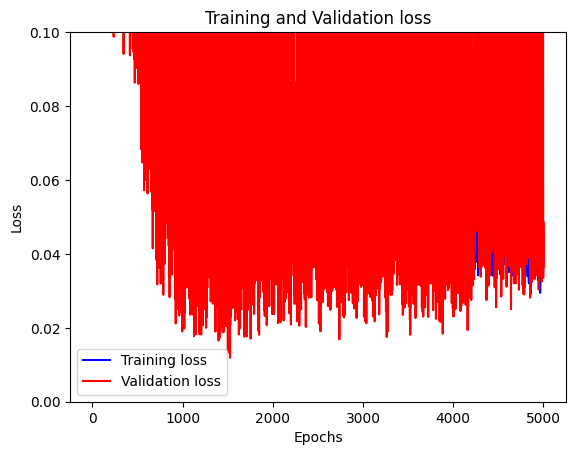

In [124]:
training_loss(history_rd)

## Results Analysis

Result on Training Dataset

In [125]:
y_train_result_rd = model_rd.predict(X_train)

2/2 [==============================] - 1s 18ms/step


In [126]:
result_tab(y_train_rd, y_train_result_rd, Name_train)


Data Number,Mean Relative Error,Max Relative Error,Min Relative Error
0,3.004451,19.157459,0.000009
1,6.086862,14.734561,0.001291
3,4.040849,24.133453,0.000301
4,5.853366,28.406092,0.000166
6,5.122952,26.572277,0.000640
7,4.876331,21.605389,0.000608
8,6.344954,21.724277,0.000035
9,5.108982,22.916642,0.001140
11,4.969331,22.191074,0.000327
12,6.417203,18.398846,0.011852


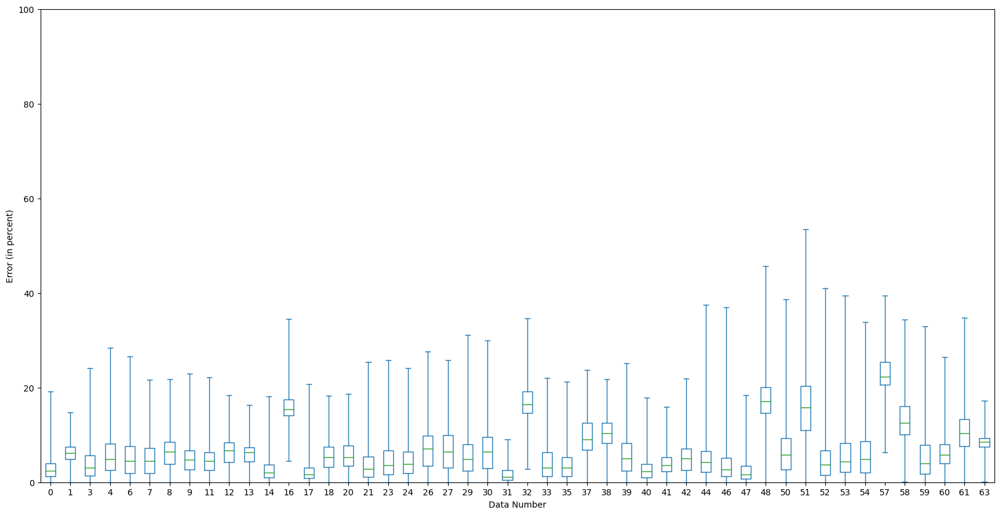

In [127]:
boxplot(y_train_rd, y_train_result_rd, Name_train,100)

Result on Testing Dataset

In [128]:
y_test_result_rd = model_rd.predict(X_test)

1/1 [==============================] - 0s 136ms/step


In [129]:
result_tab(y_test_rd, y_test_result_rd, Name_test)

Data Number,Mean Relative Error,Max Relative Error,Min Relative Error
2,6.435286,20.136957,0.000009
10,4.370967,26.128114,0.001427
15,15.283117,66.956651,0.005480
19,4.368623,19.790057,0.000541
22,4.761704,27.364100,0.000128
28,4.457669,28.496913,0.000023
36,7.408033,17.499863,0.003102
43,7.367709,41.205867,0.000943
45,9.180358,43.854675,0.003203
49,6.414680,44.620531,0.001433


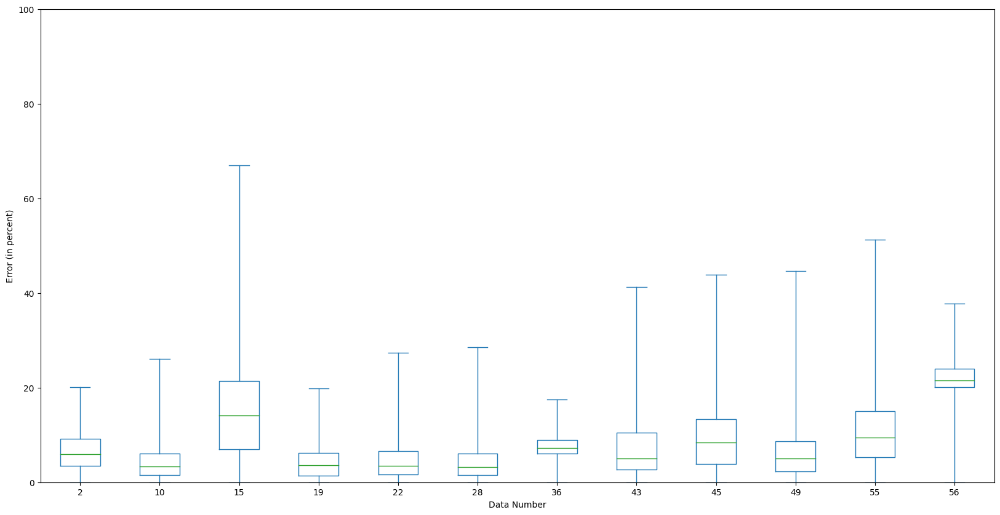

In [130]:
boxplot(y_test_rd, y_test_result_rd, Name_test,100)

# Neural Network : Normalization

## For Input Data

Normalization

$U_{\text{norm}} = \frac{U_{\text{in}} - \text{min}(U_{\text{in}})}{\text{max}(U_{\text{in}}) - \text{min}(U_{\text{in}})}$


In [131]:
from sklearn.preprocessing import MinMaxScaler

scaler_N = MinMaxScaler()
scaler_N.fit(X_train)

MinMaxScaler()

In [132]:
X_train_N = scaler_N.transform(X_train)
X_val_N = scaler_N.transform(X_val)
X_test_N = scaler_N.transform(X_test)

## Training

In [133]:
if Training:

  model_N, history_N = train_model(X_train_N, y_train,X_val_N,y_val,83184)
  model_N.save(url + 'Research_Project/Winter/Model/model_Winter_N.h5')
  with open(url + 'Research_Project/Winter/History/history_Winter_N.pkl', 'wb') as f:
    pickle.dump(history_N, f)

In [134]:
if not Training:

  model_N = load_model(url + 'Research_Project/Winter/Model/model_Winter_N.h5')
  with open(url + 'Research_Project/Winter/History/history_Winter_N.pkl', 'rb') as f:
    history_N = pickle.load(f)

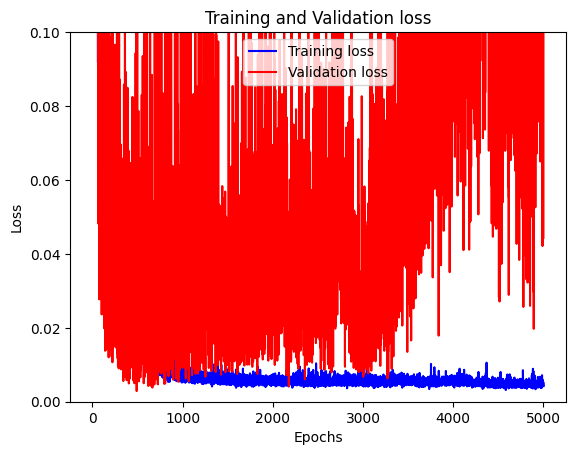

In [135]:
training_loss(history_N)

## Results Analysis

### Test on Training Dataset

In [136]:
y_train_result_N = model_N.predict(X_train_N)

2/2 [==============================] - 0s 27ms/step


In [137]:
y_train_result_N_plot = np.array([y_train_result_N[i] for i in index_train_plot])

<ipython-input-83-5edb99b9a23e>:41: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



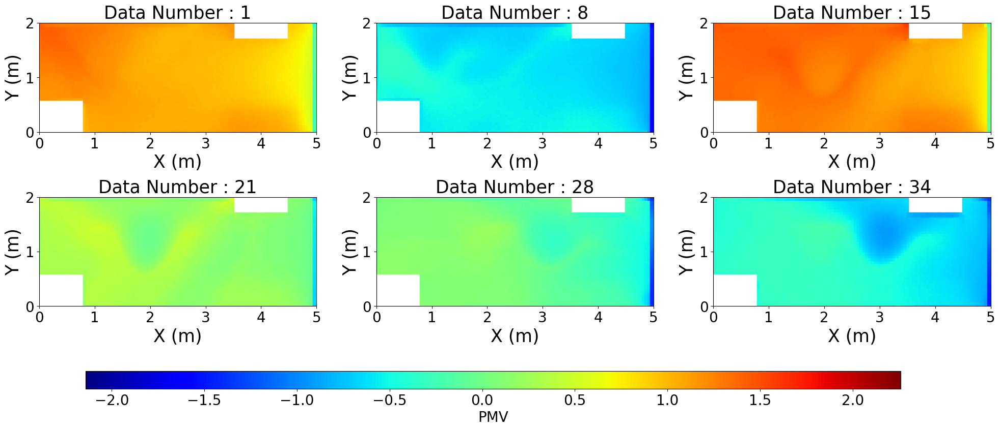

In [138]:
plot(y_train_result_N_plot,df_base,Name_train_plot,0.975)

### Test on Testing Dataset

In [139]:
y_test_result_N = model_N.predict(X_test_N)

1/1 [==============================] - 0s 152ms/step


In [140]:
y_test_result_N_plot = np.array([y_test_result_N[i] for i in index_test_plot])

<ipython-input-83-5edb99b9a23e>:41: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



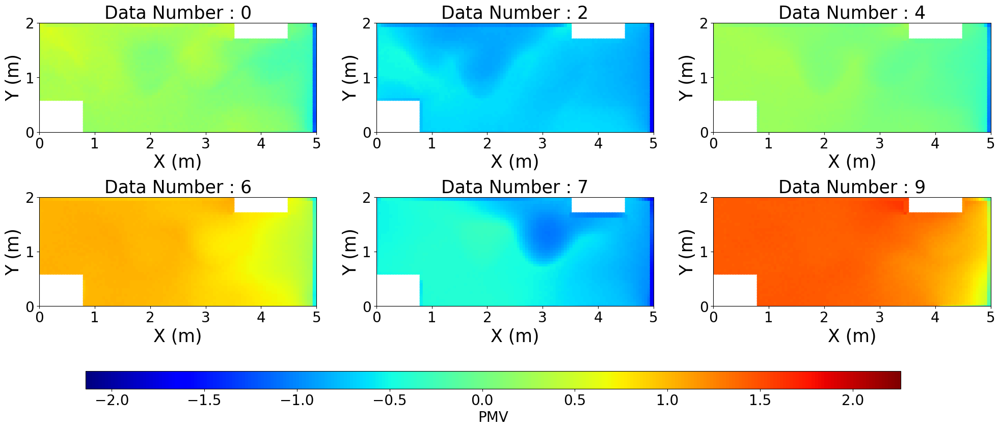

In [141]:
plot(y_test_result_N_plot,df_base,Name_test_plot,0.975)

### Results Analysis

Result on Training Dataset

In [142]:
result_tab(y_train, y_train_result_N, Name_train)


Data Number,Mean Relative Error,Max Relative Error,Min Relative Error
0,2.554389,4.652790,0.000132
1,1.796438,5.266733,0.000032
3,5.674778,32.075395,0.000004
4,2.115922,5.149025,0.000220
6,1.012557,5.970356,0.000020
7,0.805651,5.697762,0.000041
8,4.783416,13.772281,0.000742
9,1.404603,8.351793,0.000004
11,0.677544,9.199377,0.000011
12,3.097015,9.328040,0.000332


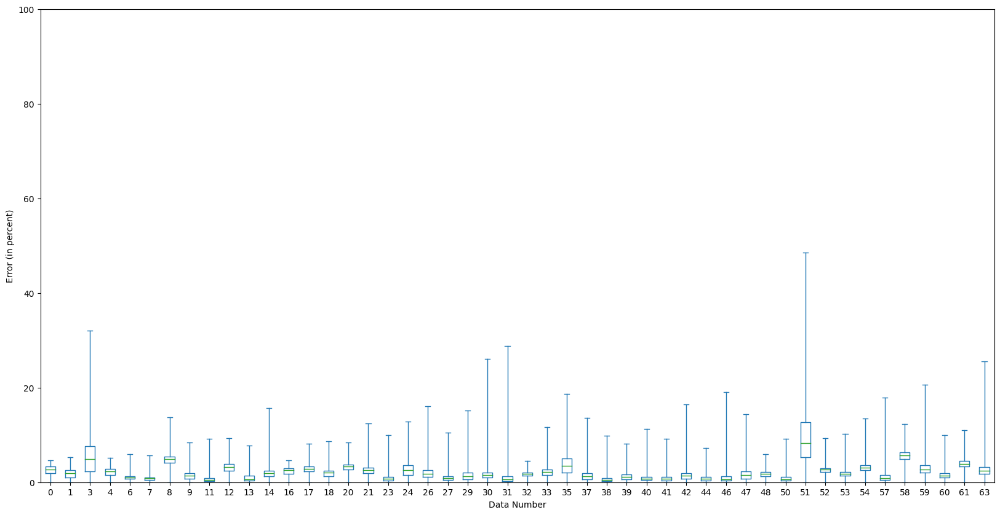

In [143]:
boxplot(y_train, y_train_result_N, Name_train,100)

Result on Testing Dataset

In [144]:
result_tab(y_test, y_test_result_N, Name_test)

Data Number,Mean Relative Error,Max Relative Error,Min Relative Error
2,8.705027,22.567501,0.000631
10,3.673840,22.371559,0.000177
15,2.707708,30.027407,0.000017
19,5.710526,33.799805,0.000230
22,2.740000,24.557807,0.000034
28,5.262023,56.777988,0.000222
36,17.423834,32.913251,0.006292
43,4.930222,23.901359,0.000042
45,2.506724,42.865467,0.000019
49,2.713478,18.384452,0.006264


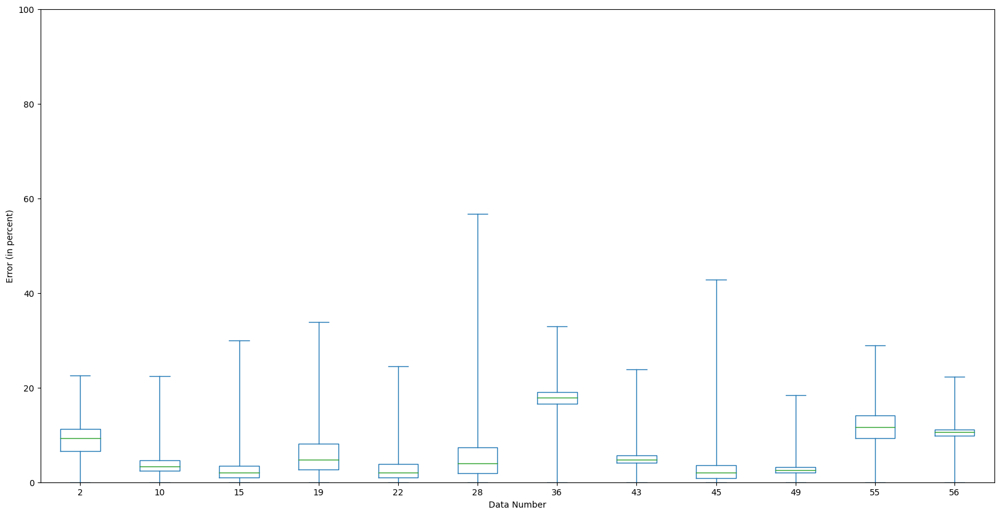

In [145]:
boxplot(y_test, y_test_result_N, Name_test,100)

In [146]:
plot_3D_result(y_test[2], y_test_result_N[2], ['Data','Result'])

GridspecLayout(children=(FloatSlider(value=0.025, description='X:', layout=Layout(grid_area='widget001'), max=…

# Neural Network : Standardization

## For Input Data

Standardization

$ U_{stand} = \frac{{U_{in} - \mu}}{{\sigma}} $


*   $ \mu$ is the mean of the inlet velocity
*   $ \sigma$ is the variance of the inlet velocity


In [147]:
from sklearn.preprocessing import StandardScaler

scaler_S = StandardScaler()
scaler_S.fit(X_train)

StandardScaler()

In [148]:
X_train_S = scaler_S.transform(X_train)
X_val_S =  scaler_S.transform(X_val)
X_test_S =  scaler_S.transform(X_test)

## Training

In [149]:
if Training:

  model_S, history_S = train_model(X_train_S, y_train,X_val_S,y_val,83184)
  model_S.save(url + 'Research_Project/Winter/Model/model_Winter_S.h5')
  with open(url + 'Research_Project/Winter/History/history_Winter_S.pkl', 'wb') as f:
    pickle.dump(history_S, f)

In [150]:
if not Training:

  model_S = load_model(url + 'Research_Project/Winter/Model/model_Winter_S.h5')
  with open(url + 'Research_Project/Winter/History/history_Winter_S.pkl', 'rb') as f:
    history_S = pickle.load(f)

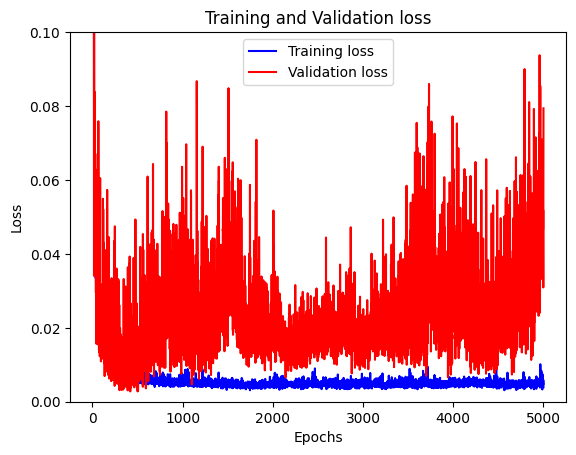

In [151]:
training_loss(history_S)

## Results Analysis

### Test on Training Dataset

In [152]:
y_train_result_S = model_S.predict(X_train_S)

2/2 [==============================] - 0s 15ms/step


In [153]:
y_train_result_S_plot = np.array([y_train_result_S[i] for i in index_train_plot])

<ipython-input-83-5edb99b9a23e>:41: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



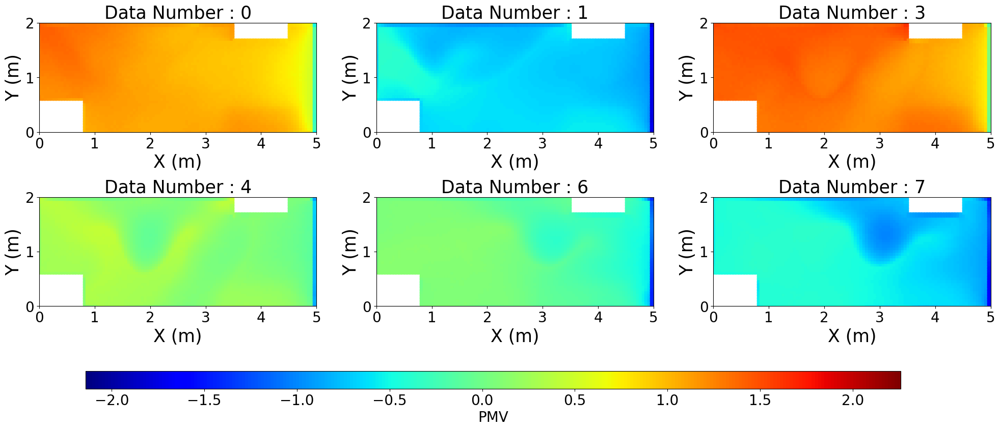

In [154]:
plot(y_train_result_S_plot,df_base,Name_train,0.975)

### Test on Testing Dataset

In [155]:
y_test_result_S = model_S.predict(X_test_S)

1/1 [==============================] - 0s 26ms/step


In [156]:
y_test_result_S_plot = np.array([y_test_result_S[i] for i in index_test_plot])

<ipython-input-83-5edb99b9a23e>:41: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



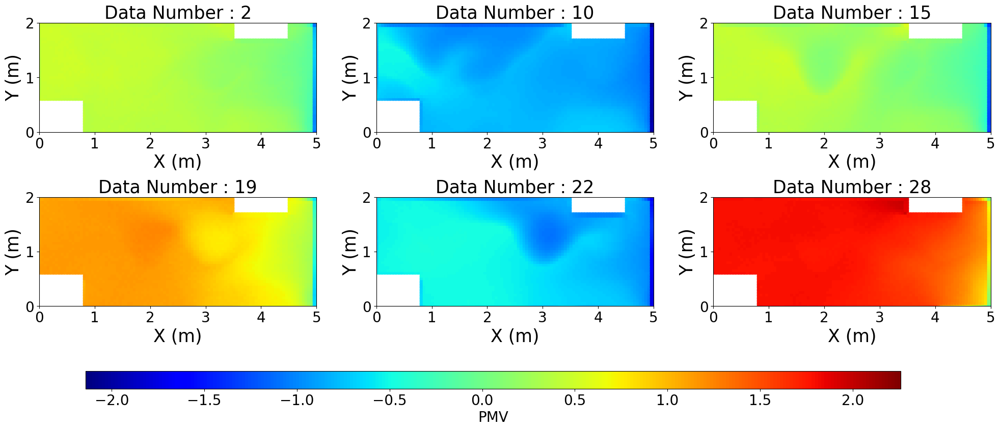

In [157]:
plot(y_test_result_S_plot,df_base,Name_test,0.975)

### Results Analysis

Result on Training Dataset

In [158]:
result_tab(y_train, y_train_result_S, Name_train)


Data Number,Mean Relative Error,Max Relative Error,Min Relative Error
0,2.791195,10.073002,0.000006
1,1.809034,8.713065,0.000237
3,7.345158,45.868874,0.000099
4,1.764219,10.382453,0.000021
6,2.242603,8.685529,0.000583
7,2.773767,21.007054,0.000032
8,2.087536,7.808486,0.000498
9,1.252577,6.678835,0.000021
11,5.095613,13.253527,0.237872
12,2.602525,12.326360,0.000169


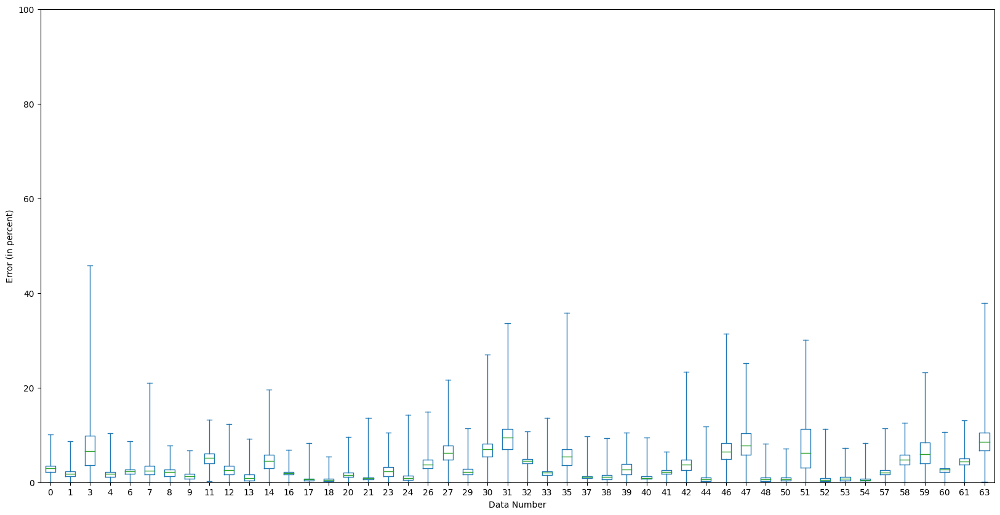

In [159]:
boxplot(y_train, y_train_result_S, Name_train,100)

Result on Testing Dataset

In [160]:
result_tab(y_test, y_test_result_S, Name_test)

Data Number,Mean Relative Error,Max Relative Error,Min Relative Error
2,4.455872,23.425743,0.000112
10,11.402777,42.097199,0.035298
15,11.772447,52.834089,0.000833
19,7.877890,50.265480,0.000318
22,5.384137,24.560499,0.000693
28,4.482204,52.496869,0.000008
36,15.061183,32.420427,0.005779
43,1.812786,37.831776,0.000028
45,21.051072,49.423565,2.750872
49,16.683049,33.259850,4.922665


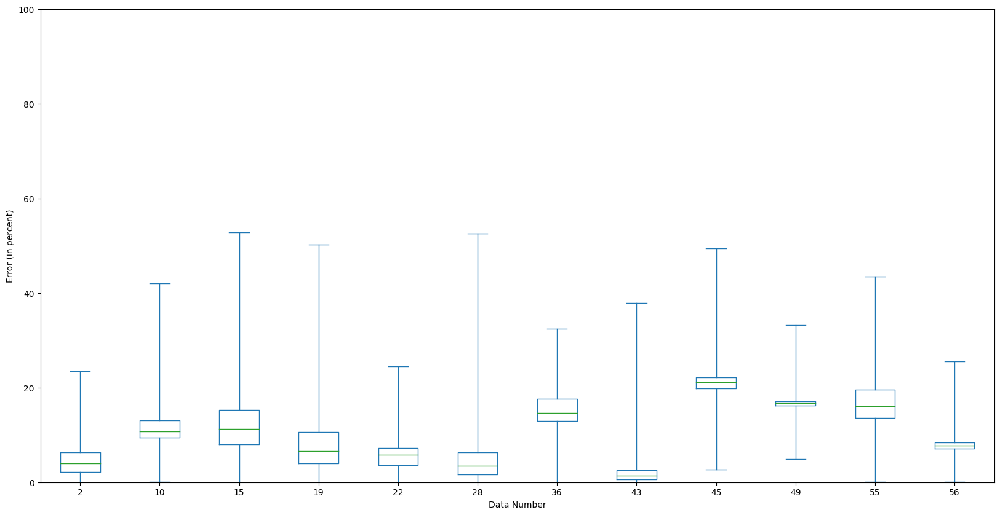

In [161]:
boxplot(y_test, y_test_result_S, Name_test,100)

In [162]:
plot_3D_result(y_test[0], y_test_result_S[0], ['Data','Result'])

GridspecLayout(children=(FloatSlider(value=0.025, description='X:', layout=Layout(grid_area='widget001'), max=…

# Comparison


## Functions

In [163]:
from matplotlib.patches import PathPatch
def boxplot_comparison(ys, y_results, names,ymax,colors,legend_labels):
  result_df = pd.DataFrame()
  output_df = pd.DataFrame()
  for i, y_result in enumerate(y_results):
    Error = Erreur_relative(ys[i], y_result)
    Error = np.transpose(Error)
    df = pd.DataFrame(Error)
    result_df = pd.concat([result_df, df], axis=1)

  for i in range(len(y_results[0])):
    output_df = pd.concat([output_df, result_df[i]], axis=1)
  output_df=output_df.astype(float)
  output_df.columns = range(output_df.shape[1])

  ax = output_df.plot(kind='box',whis=[0, 100] ,patch_artist = True,figsize = (20,10))

  children = ax.get_children()
  compteur = 0
  box = len(ys)
  for i, child in enumerate(children):
    if isinstance(child, PathPatch) :
      for j in range(box):
        if compteur % box == j:
          child.set_color(colors[j])
      compteur+=1


  ax.set_ylim(0, ymax)

  positions = np.linspace((box+1)/2, box*len(names)+1-(box+1)/2, len(names))
  ax.set_xticks(positions)
  ax.set_xticklabels(names, fontsize=15)

  ax.set_xlabel('Data Number', fontsize=20)
  ax.set_ylabel('Error (in percent)', fontsize=20)

  ax.tick_params(axis='x', labelsize=15)  # Adjust x-axis tick label size
  ax.tick_params(axis='y', labelsize=15)  # Adjust y-axis tick label size

  custom_legend = [plt.Line2D([0], [0], color=color, lw=6) for color in colors]
  ax.legend(custom_legend, legend_labels, fontsize=20)

  plt.show()

In [164]:
import pandas as pd

def tab_comparison(y, y_results, names,column_names):
  # Initialize an empty DataFrame to store the results
  result_df = pd.DataFrame()
  result_df['Data Number'] = names

  for i, y_result in enumerate(y_results):
      # Calculate relative errors
      Error = Erreur_relative(y[i], y_result)
      df = pd.DataFrame(Error)

      # Calculate mean, max, and min relative errors
      df[column_names[i]] = df.mean(axis=1)

      # Concatenate the current results with the overall results
      result_df = pd.concat([result_df, df[column_names[i]]], axis=1)

  means = result_df.mean(axis=0)

  # Add a new row with the means to the DataFrame
  result_df.loc[len(result_df)] = ['Mean'] + list(means[1:])

  latex_table = result_df.to_latex(index=False)

  #return latex_table
  return result_df.style.hide()

## On Training Data

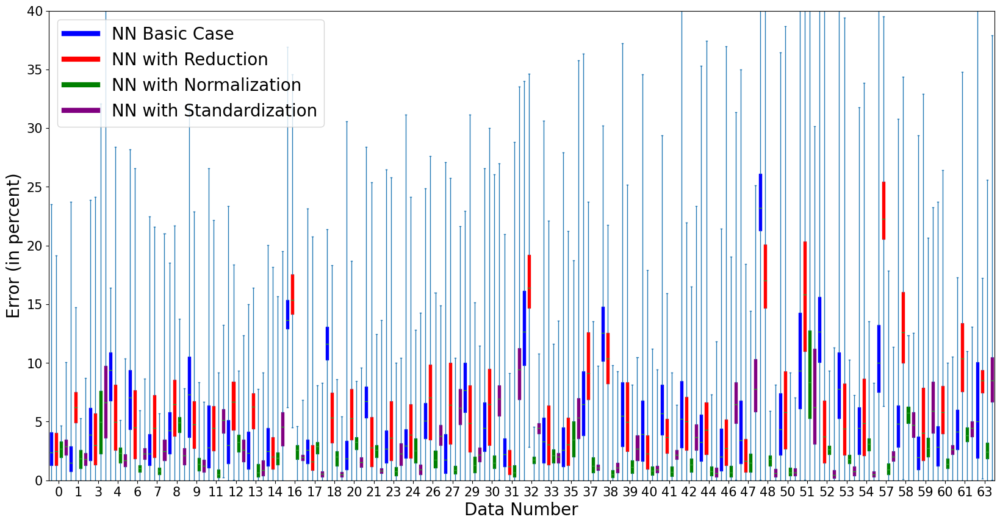

In [165]:
boxplot_comparison([y_train,y_train_rd, y_train, y_train], [y_train_result,y_train_result_rd, y_train_result_N, y_train_result_S], Name_train,40,["blue","red",'green', "purple"], ['NN Basic Case','NN with Reduction',"NN with Normalization", 'NN with Standardization'])

In [166]:
tab_comparison([y_train,y_train_rd, y_train, y_train], [y_train_result,y_train_result_rd, y_train_result_N, y_train_result_S], Name_train, ['NN Basic Case','NN with Reduction',"NN with Normalization", 'NN with Standardization'])

Data Number,NN Basic Case,NN with Reduction,NN with Normalization,NN with Standardization
0,3.162899,3.004451,2.554389,2.791195
1,2.529164,6.086862,1.796438,1.809034
3,4.505683,4.040849,5.674778,7.345158
4,8.539018,5.853366,2.115922,1.764219
6,7.522701,5.122952,1.012557,2.242603
7,3.186916,4.876331,0.805651,2.773767
8,4.157234,6.344954,4.783416,2.087536
9,7.913039,5.108982,1.404603,1.252577
11,4.534990,4.969331,0.677544,5.095613
12,3.642687,6.417203,3.097015,2.602525


## On Testing Data

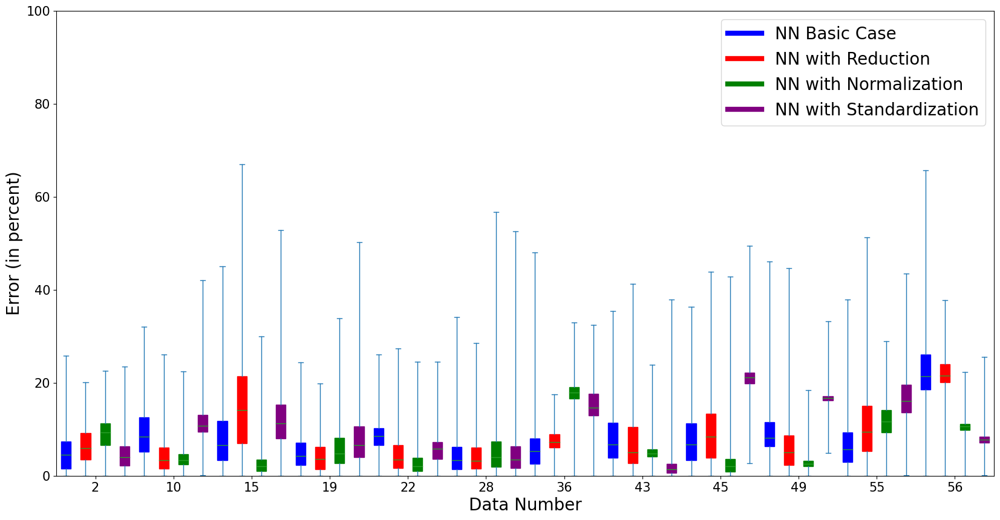

In [167]:
boxplot_comparison([y_test,y_test_rd,y_test,y_test], [y_test_result,y_test_result_rd,y_test_result_N,y_test_result_S], Name_test, 100,["blue","red",'green', "purple"], ['NN Basic Case','NN with Reduction',"NN with Normalization", 'NN with Standardization'])

In [168]:
tab_comparison([y_test,y_test_rd,y_test,y_test], [y_test_result,y_test_result_rd,y_test_result_N,y_test_result_S], Name_test, ['NN Basic Case','NN with Reduction',"NN with Normalization", 'NN with Standardization'])

Data Number,NN Basic Case,NN with Reduction,NN with Normalization,NN with Standardization
2,5.295937,6.435286,8.705027,4.455872
10,9.358476,4.370967,3.673840,11.402777
15,8.700233,15.283117,2.707708,11.772447
19,4.967127,4.368623,5.710526,7.877890
22,8.321956,4.761704,2.740000,5.384137
28,4.624070,4.457669,5.262023,4.482204
36,5.820800,7.408033,17.423834,15.061183
43,8.260912,7.367709,4.930222,1.812786
45,7.860224,9.180358,2.506724,21.051072
49,9.609563,6.414680,2.713478,16.683049


# Feature importance

In [169]:
plt.rcParams.update({'font.size': 20})

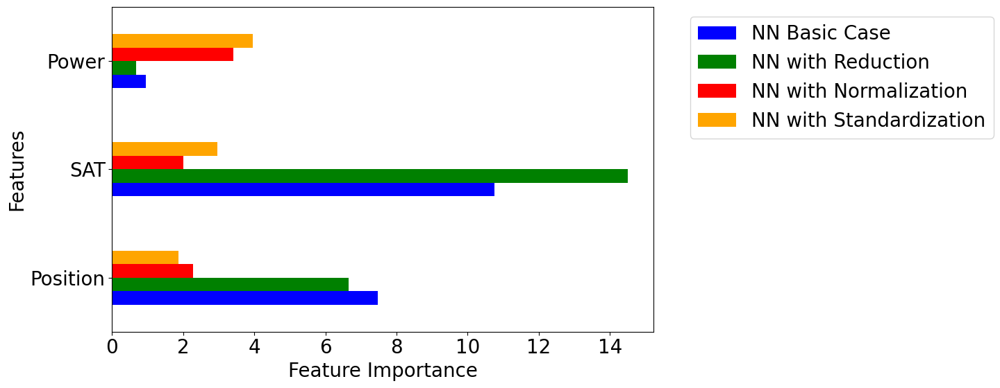

In [170]:
models = [model, model_rd, model_N, model_S]
models_name = ['NN Basic Case', 'NN with Reduction', 'NN with Normalization', 'NN with Standardization']
colors = ['blue', 'green', 'red', 'orange']

feature_importance_df = pd.DataFrame(index=['Position', 'SAT', 'Power'])

for i, model in enumerate(models):

    weights = model.get_weights()
    feature_importance = np.sum(np.abs(weights[0]), axis=1)
    feature_importance_df[models_name[i]] = feature_importance

fig, ax = plt.subplots(figsize=(15, 6))

feature_importance_df.plot(kind='barh', color=colors, ax=ax)
ax.set_xlabel('Feature Importance')
ax.set_ylabel('Features')

ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1))

plt.tight_layout()
plt.show()

